# Training the neural network
Please only do this once you've run `main.py` and download the files and press the save button, as this relys on having the savestate avaliable

In [69]:
# Get savestate
from pickle import load
with open('cache/savestate.pkl', 'rb') as f:
    files = load(f)

files

{'Names':      Location    State                                   Name      Lat   
 0       15590       NT                  ALICE SPRINGS AIRPORT -23.7951  \
 1       14272       NT                      BATCHELOR AIRPORT -13.0544   
 2       14723       NT                     BORROLOOLA AIRPORT -16.0755   
 3       14954       NT                               BRADSHAW -14.9408   
 4       14808       NT  BRADSHAW - ANGALLARI VALLEY (DEFENCE) -15.4397   
 ..        ...      ...                                    ...      ...   
 642     92037  Unknown                 SWAN ISLAND LIGHTHOUSE -40.7300   
 643     94061  Unknown                     SANDFORD (MAYDENA) -42.9300   
 644     94063  Unknown                       SORELL (WHITLEA) -42.7900   
 645     95016  Unknown                               OSTERLEY -42.3400   
 646     99001  Unknown                            DEAL ISLAND -39.4800   
 
          Long  
 0    133.8890  
 1    131.0252  
 2    136.3041  
 3    130.8091  
 4  

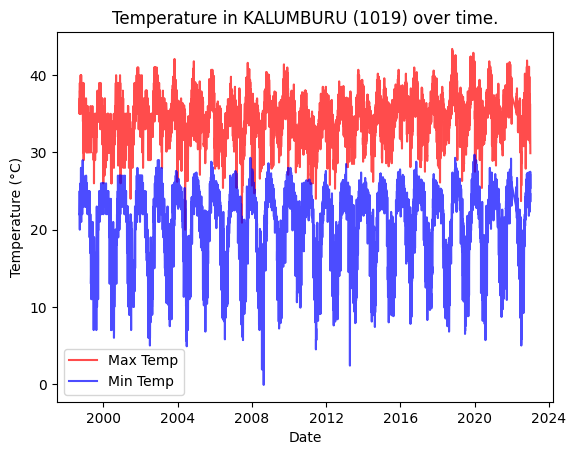

In [70]:
import matplotlib.pyplot as plt
from random import randint
while True:
    place = files['Names'].loc[randint(0, len(files['Names']))]
    if '0'*(6-len(str(place.Location)))+str(place.Location) in files['Temps']:
        break
# place = '27042'

tempdf = files['Temps']['0'*(6-len(str(place.Location)))+str(place.Location)]
plt.plot(tempdf['Date'], tempdf['MaxTemp'], label='Max Temp', color="red", alpha=0.7)
plt.plot(tempdf['Date'], tempdf['MinTemp'], label='Min Temp', color="blue", alpha=0.7)
plt.legend()
#plt.fill_between(df['Date'], df['MaxTemp'], df['MinTemp'], alpha=0.3)
plt.xlabel('Date')
plt.ylabel('Temperature (°C)')
plt.title(f'Temperature in {place.Name} ({place.Location}) over time.')
plt.show()
# PLEASE NOTE: If there is a gap, it is because there is no data for that time. This is not an error.

Borrowed code from https://github.com/mumarse/Sin_Wave_Prediction/blob/master/RNN-LSTM-SineWave.ipynb

,Temp
0,36.0
1,35.0
2,36.0
3,36.0
4,37.0
...,...
8416,35.8
8417,33.3
8418,32.2
8419,30.5


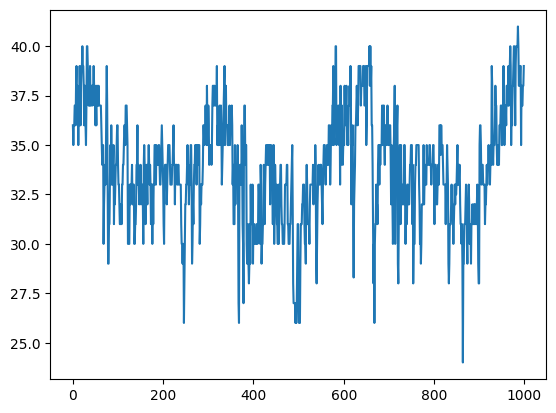

In [71]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# Generate the sin wave
#x = np.linspace(0,100,5001)
#y = 5 * np.sin(x) + np.random.normal(0,2,5001) + 25
# Turn it into a dataframe
#df = pd.DataFrame(data=y,columns=['Temp'])
df = pd.DataFrame(data=tempdf['MaxTemp'],columns=['Temp'])
# Plot it
plt.plot(df.iloc[:1000])
df

In [89]:
# Split training and testing data
# test_percent = 0.1
# test_ind = int(len(df) - np.round(len(df)*test_percent))
# train = df.iloc[:test_ind]
# test = df.iloc[test_ind:]
test_amount = 7
test_window = 1000
train_amount = len(df)-test_window

# define generator
batch_size = 20 # Number of timeseries samples in each batch
length = 30 # Length of the output sequences (in number of timesteps)

train = df.iloc[:train_amount]

# Scale data
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaled_full_data = scaler.fit_transform(train)
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
generator = TimeseriesGenerator(scaled_full_data, scaled_full_data, length=length, batch_size=batch_size)
# What does the first batch look like?
X,y = generator[0]
print(f'Given the Array: \n{X.flatten()}')
print(f'Predict this y: \n {y}')

Given the Array: 
[0.68376068 0.64102564 0.68376068 0.68376068 0.72649573 0.72649573
 0.68376068 0.76923077 0.81196581 0.72649573 0.76923077 0.72649573
 0.64102564 0.72649573 0.68376068 0.81196581 0.72649573 0.68376068
 0.76923077 0.81196581 0.81196581 0.85470085 0.81196581 0.81196581
 0.76923077 0.68376068 0.76923077 0.76923077 0.68376068 0.64102564
 0.64102564 0.68376068 0.68376068 0.72649573 0.72649573 0.68376068
 0.76923077 0.81196581 0.72649573 0.76923077 0.72649573 0.64102564
 0.72649573 0.68376068 0.81196581 0.72649573 0.68376068 0.76923077
 0.81196581 0.81196581 0.85470085 0.81196581 0.81196581 0.76923077
 0.68376068 0.76923077 0.76923077 0.68376068 0.64102564 0.72649573
 0.68376068 0.68376068 0.72649573 0.72649573 0.68376068 0.76923077
 0.81196581 0.72649573 0.76923077 0.72649573 0.64102564 0.72649573
 0.68376068 0.81196581 0.72649573 0.68376068 0.76923077 0.81196581
 0.81196581 0.85470085 0.81196581 0.81196581 0.76923077 0.68376068
 0.76923077 0.76923077 0.68376068 0.64102564

In [90]:
# Create the model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout, SimpleRNN
n_features = 1
model = Sequential([
    LSTM(length, input_shape=(length, n_features)),
    #Dropout(0.2),
    #Dense(500, activation='relu'),
    #Dense(500, activation='relu', input_shape=(None, 500)),
    #Dense(500, activation='relu', input_shape=(None, 500)),
    #Dropout(0.2),
    #SimpleRNN(50, input_shape=(None, 500)),
    Dense(1)
])
model.compile(optimizer='adam', loss='mse')
model.fit(generator,epochs=6)

model.summary()

Epoch 1/6
370/370 [==============================] - 3s 6ms/step - loss: 0.0207
Epoch 2/6
370/370 [==============================] - 2s 5ms/step - loss: 0.0063
Epoch 3/6
370/370 [==============================] - 2s 5ms/step - loss: 0.0057
Epoch 4/6
370/370 [==============================] - 2s 5ms/step - loss: 0.0052
Epoch 5/6
370/370 [==============================] - 2s 5ms/step - loss: 0.0047
Epoch 6/6
370/370 [==============================] - 2s 6ms/step - loss: 0.0044
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_7 (LSTM)               (None, 30)                3840      
                                                                 
 dense_7 (Dense)             (None, 1)                 31        
                                                                 
Total params: 3,871
Trainable params: 3,871
Non-trainable params: 0
__________________________________

<Axes: >

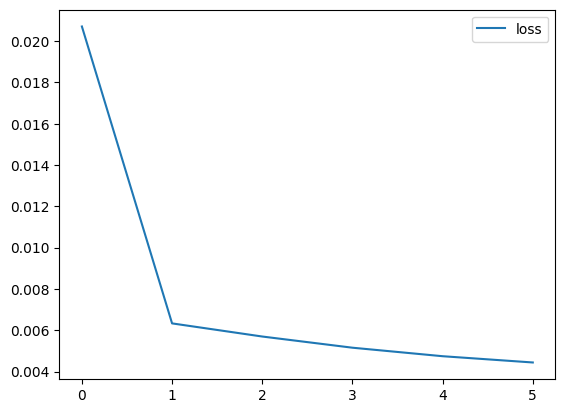

In [91]:
losses = pd.DataFrame(model.history.history)
losses.plot()

In [92]:
first_eval_batch = scaled_full_data[-length:]
first_eval_batch.reshape((1, length, n_features))

array([[[0.75213675],
        [0.76495726],
        [0.78205128],
        [0.85042735],
        [0.88034188],
        [0.91880342],
        [0.79487179],
        [0.82051282],
        [0.83333333],
        [0.85470085],
        [0.81623932],
        [0.88461538],
        [0.97863248],
        [0.95726496],
        [0.72222222],
        [0.7991453 ],
        [0.82051282],
        [0.84615385],
        [0.88888889],
        [0.82478632],
        [0.78632479],
        [0.85897436],
        [0.88461538],
        [0.82478632],
        [0.82905983],
        [0.90598291],
        [0.8034188 ],
        [0.82478632],
        [0.7991453 ],
        [0.7991453 ]]])

In [93]:
offset = randint(0, test_window)
test = df.iloc[-test_amount-length-offset:-offset]
scaled_test_data = scaler.fit_transform(test)

In [100]:
forecast = []
closenesses = []

first_eval_batch = scaled_test_data[:length]
current_batch = first_eval_batch.reshape((1, length, n_features))

tot = len(test)
for i in range(tot-length):
    # get prediction 1 time stamp ahead ([0] is for grabbing just the number instead of [array])
    current_pred = model.predict(current_batch)[0]
    
    unscaled_pred = scaler.inverse_transform(current_pred.reshape(-1,1))[0]
    # store prediction
    forecast.append(unscaled_pred)
    # Add how close it is to the list
    closenesses.append(abs(unscaled_pred - test.iloc[length+i]))
    # update batch to now include prediction and drop first value
    current_batch = np.append(current_batch[:,1:,:],[[current_pred]],axis=1)

1/1 [==============================] - 0s 14ms/step


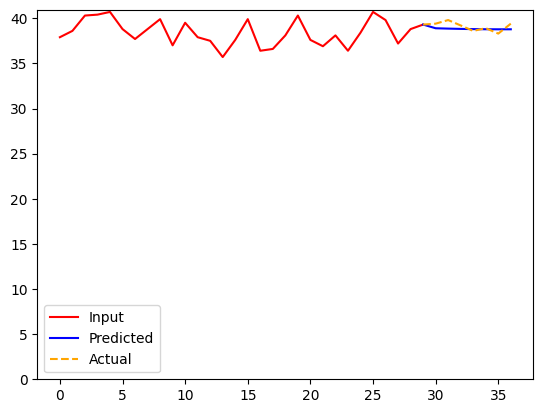

In [118]:
initial = first_eval_batch
plt.plot(scaler.inverse_transform(initial), 'r-', label='Input')
x_axis = range(len(initial)-1, len(initial)+len(test)-length)
plt.plot(x_axis, list(scaler.inverse_transform(initial[-1].reshape(1, -1))[0])+[i[0] for i in forecast], 'b-', label='Predicted')
plt.plot(x_axis, np.append(scaler.inverse_transform(initial[-1].reshape(1, -1))[0],scaler.inverse_transform(scaled_test_data[length:])), '--', color='orange', label='Actual')
plt.legend()
plt.ylim(ymin=0)
plt.show()

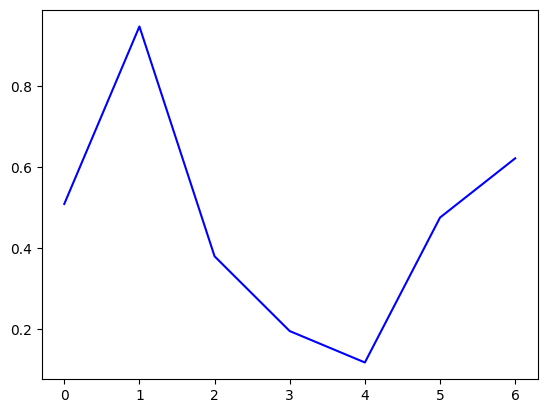

In [119]:
plt.plot(closenesses, 'b-')
plt.show()

### **PLEASE NOTE**:
You may see the AI predict a straight line; or at least one that isn't all jagged or rough like the real data. This is because it is actually *kind of* predicting the average of the data because that is actually the **best** way to get the *most* accurate predictions.

Think about it; if you accidentally predicted a jagged line that was exactly opposite to the real data it would be **extremly incorrect!!** So, the average is the most correct method for predicting data.